## Super resolution

In [1]:
import fastai
from fastai.vision import *
from fastai.callbacks import *

from torchvision.models import vgg16_bn

from pathlib import Path

In [2]:
import os
len(os.listdir("/home/dl/data/vrep/v2/cam_1_tex/"))

107416

In [3]:
# import os
# import matplotlib.image as im
# c = 0
# tex_folder = '/home/dl/data/vrep/v2/cam_1_tex/'
# can_folder = '/home/dl/data/vrep/v2/cam_1_can/'
# msk_folder = '/home/dl/data/vrep/v2/cam_1_msk/'
# for i, file in enumerate(os.listdir(tex_folder)):
#     try:
#         im.imread(tex_folder + file)
#         im.imread(can_folder + file)
#         im.imread(msk_folder + file)
#     except:
#         if file == 'models': continue
#         c += 1
#         # remove the file
#         print(i, c)
#         os.remove(tex_folder + file)
#         os.remove(can_folder + file)
#         os.remove(msk_folder + file)

In [4]:
path = Path('/home/dl/data/vrep/v2/')
path_noisy = path/'cam_1_tex' #h
path_clean = path/'cam_1_can' #l

In [5]:
il = ImageItemList.from_folder(path_noisy)

In [6]:
bs,size=64,128
arch = models.resnet34
src = ImageImageList.from_folder(path_noisy).random_split_by_pct(0.1, seed=42)

In [7]:
def get_data(bs,size):
    data = (src.label_from_func(lambda x: path_clean/x.name)
           .transform(get_transforms(max_zoom=2.), size=size, tfm_y=True)
           .databunch(bs=bs).normalize(imagenet_stats, do_y=True))

    data.c = 3
    return data

In [8]:
data = get_data(bs,size)

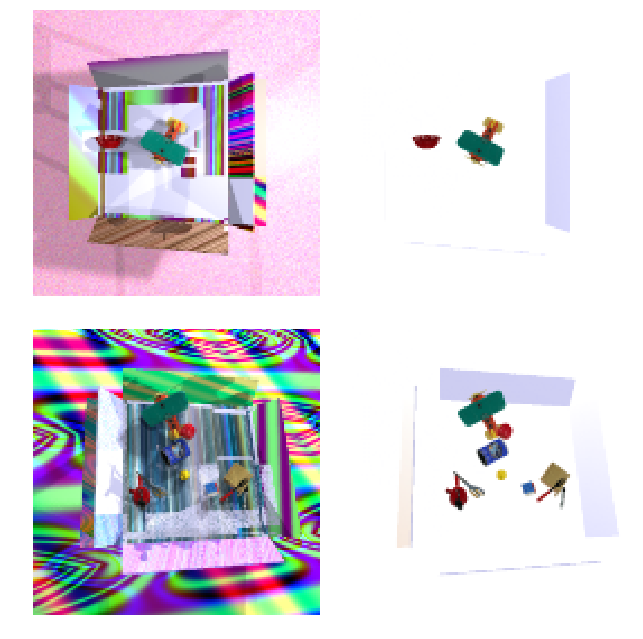

In [9]:
data.show_batch(ds_type=DatasetType.Valid, rows=2, figsize=(9,9))

## Feature loss

In [10]:
t = data.valid_ds[0][1].data
t = torch.stack([t,t])

In [11]:
def gram_matrix(x):
    n,c,h,w = x.size()
    x = x.view(n, c, -1)
    return (x @ x.transpose(1,2))/(c*h*w)

In [12]:
gram_matrix(t)

tensor([[[0.3232, 0.3228, 0.3245],
         [0.3228, 0.3231, 0.3247],
         [0.3245, 0.3247, 0.3267]],

        [[0.3232, 0.3228, 0.3245],
         [0.3228, 0.3231, 0.3247],
         [0.3245, 0.3247, 0.3267]]])

In [13]:
#l1_loss - Jeremy's preference
base_loss = F.mse_loss

In [14]:
vgg_m = vgg16_bn(True).features.cuda().eval()
requires_grad(vgg_m, False)

In [15]:
blocks = [i-1 for i,o in enumerate(children(vgg_m)) if isinstance(o,nn.MaxPool2d)]
blocks, [vgg_m[i] for i in blocks]

([5, 12, 22, 32, 42],
 [ReLU(inplace), ReLU(inplace), ReLU(inplace), ReLU(inplace), ReLU(inplace)])

In [16]:
class FeatureLoss(nn.Module):
    def __init__(self, m_feat, layer_ids, layer_wgts):
        super().__init__()
        self.m_feat = m_feat
        self.loss_features = [self.m_feat[i] for i in layer_ids]
        self.hooks = hook_outputs(self.loss_features, detach=False)
        self.wgts = layer_wgts
        self.metric_names = ['pixel',] + [f'feat_{i}' for i in range(len(layer_ids))
              ] + [f'gram_{i}' for i in range(len(layer_ids))]

    def make_features(self, x, clone=False):
        self.m_feat(x)
        return [(o.clone() if clone else o) for o in self.hooks.stored]
    
    def forward(self, input, target):
        out_feat = self.make_features(target, clone=True)
        in_feat = self.make_features(input)
        self.feat_losses = [base_loss(input,target)]
        self.feat_losses += [base_loss(f_in, f_out)*w
                             for f_in, f_out, w in zip(in_feat, out_feat, self.wgts)]
        self.feat_losses += [base_loss(gram_matrix(f_in), gram_matrix(f_out))*w**2 * 5e3
                             for f_in, f_out, w in zip(in_feat, out_feat, self.wgts)]
        self.metrics = dict(zip(self.metric_names, self.feat_losses))
        return sum(self.feat_losses)
    
    def __del__(self): self.hooks.remove()

In [17]:
feat_loss = FeatureLoss(vgg_m, blocks[2:5], [5,15,2])

## Train

In [18]:
wd = 1e-3

learn = unet_learner(data, arch, wd=wd, loss_func=feat_loss, callback_fns=LossMetrics,
                     blur=True, norm_type=NormType.Weight)
gc.collect();
learn.unfreeze()

In [ ]:
learn.lr_find()
learn.recorder.plot()

In [19]:
lr = 1e-3

In [20]:
lr

0.001

In [59]:
def do_fit(save_name, lrs=slice(lr), pct_start=0.9, n_cycles = 10):
    learn.fit_one_cycle(n_cycles, lrs, pct_start=pct_start)
    learn.save(save_name)
    learn.show_results(rows=4, imgsize=5)

In [ ]:
do_fit('1a_v2', slice(lr*10), n_cycles = 10)

In [ ]:
learn.lr_find()
learn.recorder.plot()

In [ ]:
do_fit('1b_v2', slice(1e-4), n_cycles = 5)

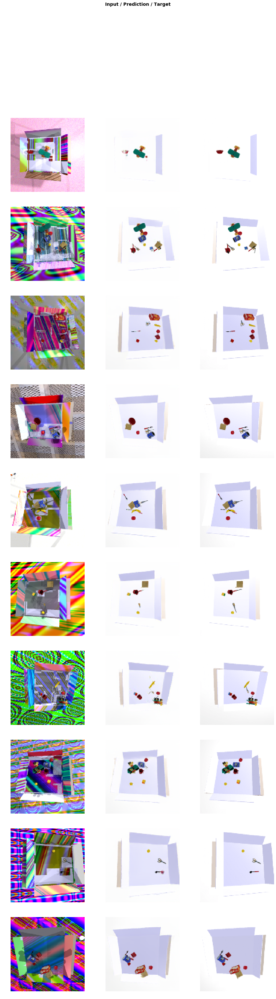

In [20]:
learn.load('1b_v2')
learn.show_results(rows=10, imgsize=5)

In [23]:
data = get_data(16,256)
learn.data = data
learn.freeze()

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


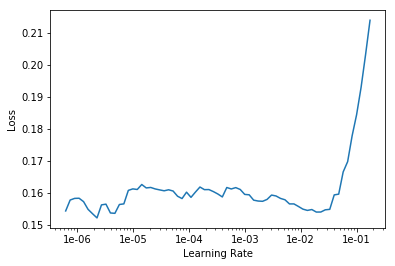

In [24]:
learn.load('1b_v2')
learn.lr_find()
learn.recorder.plot()

epoch,train_loss,valid_loss,pixel,feat_0,feat_1,feat_2,gram_0,gram_1,gram_2
1,0.108725,0.064639,0.021030,0.010209,0.017006,0.016379,0.000001,0.000011,0.000004
2,0.090837,0.061198,0.020053,0.009642,0.015826,0.015663,0.000001,0.000009,0.000003
3,0.086320,0.060122,0.019798,0.009534,0.015400,0.015377,0.000001,0.000009,0.000003
4,0.080431,0.057125,0.018551,0.009060,0.014639,0.014863,0.000001,0.000008,0.000003
5,0.076096,0.054210,0.016911,0.008773,0.014181,0.014333,0.000001,0.000008,0.000003


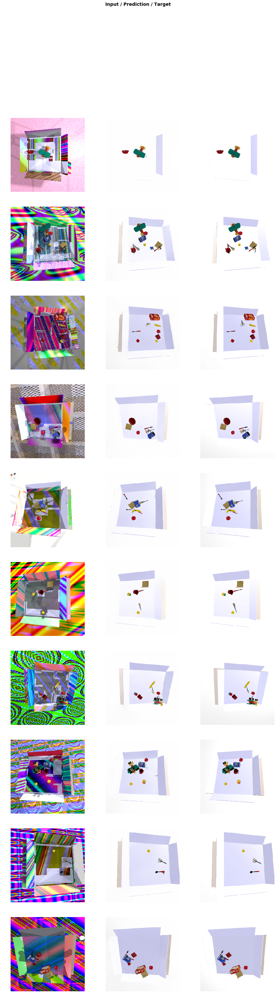

In [29]:
do_fit('2a_v2', slice(1e-3), n_cycles=5)

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


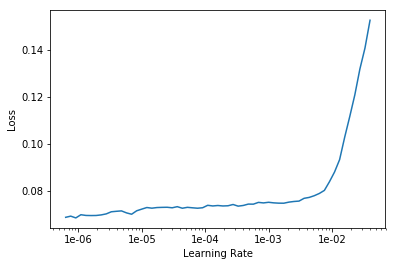

In [38]:
learn.load('2a_v2')
learn.unfreeze()
learn.lr_find()
learn.recorder.plot()

In [22]:
data = get_data(4,512)
learn.data = data
learn.freeze()

In [24]:
learn.load('2a_v2')

Learner(data=ImageDataBunch;

Train: LabelList
y: ImageItemList (96674 items)
[Image (3, 512, 512), Image (3, 512, 512), Image (3, 512, 512), Image (3, 512, 512), Image (3, 512, 512)]...
Path: /home/dl/data/vrep/v2/cam_1_tex
x: ImageImageList (96674 items)
[Image (3, 512, 512), Image (3, 512, 512), Image (3, 512, 512), Image (3, 512, 512), Image (3, 512, 512)]...
Path: /home/dl/data/vrep/v2/cam_1_tex;

Valid: LabelList
y: ImageItemList (10741 items)
[Image (3, 512, 512), Image (3, 512, 512), Image (3, 512, 512), Image (3, 512, 512), Image (3, 512, 512)]...
Path: /home/dl/data/vrep/v2/cam_1_tex
x: ImageImageList (10741 items)
[Image (3, 512, 512), Image (3, 512, 512), Image (3, 512, 512), Image (3, 512, 512), Image (3, 512, 512)]...
Path: /home/dl/data/vrep/v2/cam_1_tex;

Test: None, model=DynamicUnet(
  (layers): ModuleList(
    (0): Sequential(
      (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, af

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


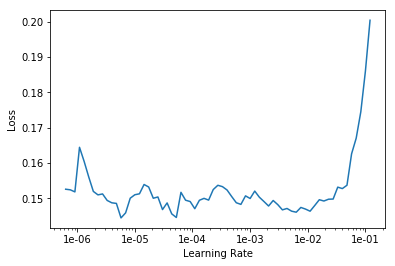

In [41]:
learn.lr_find()
learn.recorder.plot()

In [ ]:
do_fit('3a_v2',lrs=slice(1e-5), n_cycles=2)


In [45]:
learn.load('3a_v2')

Learner(data=ImageDataBunch;

Train: LabelList
y: ImageItemList (96674 items)
[Image (3, 512, 512), Image (3, 512, 512), Image (3, 512, 512), Image (3, 512, 512), Image (3, 512, 512)]...
Path: /home/dl/data/vrep/v2/cam_1_tex
x: ImageImageList (96674 items)
[Image (3, 512, 512), Image (3, 512, 512), Image (3, 512, 512), Image (3, 512, 512), Image (3, 512, 512)]...
Path: /home/dl/data/vrep/v2/cam_1_tex;

Valid: LabelList
y: ImageItemList (10741 items)
[Image (3, 512, 512), Image (3, 512, 512), Image (3, 512, 512), Image (3, 512, 512), Image (3, 512, 512)]...
Path: /home/dl/data/vrep/v2/cam_1_tex
x: ImageImageList (10741 items)
[Image (3, 512, 512), Image (3, 512, 512), Image (3, 512, 512), Image (3, 512, 512), Image (3, 512, 512)]...
Path: /home/dl/data/vrep/v2/cam_1_tex;

Test: None, model=DynamicUnet(
  (layers): ModuleList(
    (0): Sequential(
      (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, af

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


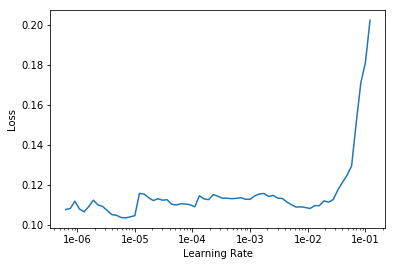

In [46]:
learn.lr_find()
learn.recorder.plot()

In [47]:
do_fit('3b_v2',lrs=slice(1e-6), n_cycles=3)

epoch,train_loss,valid_loss,pixel,feat_0,feat_1,feat_2,gram_0,gram_1,gram_2
1,0.110658,0.072551,0.032347,0.009393,0.014852,0.015951,0.000001,0.000005,0.000001
2,0.114132,0.070045,0.031052,0.009085,0.014382,0.015518,0.000001,0.000005,0.000001
3,0.108435,0.071782,0.032262,0.009203,0.014395,0.015915,0.000001,0.000005,0.000001


IndexError: index 4 is out of bounds for dimension 0 with size 4

epoch,train_loss,valid_loss,pixel,feat_0,feat_1,feat_2,gram_0,gram_1,gram_2
1,0.112499,0.069929,0.030799,0.009087,0.014351,0.015684,0.000001,0.000005,0.000001
2,0.108133,0.069197,0.030395,0.009017,0.014198,0.015581,0.000001,0.000005,0.000001


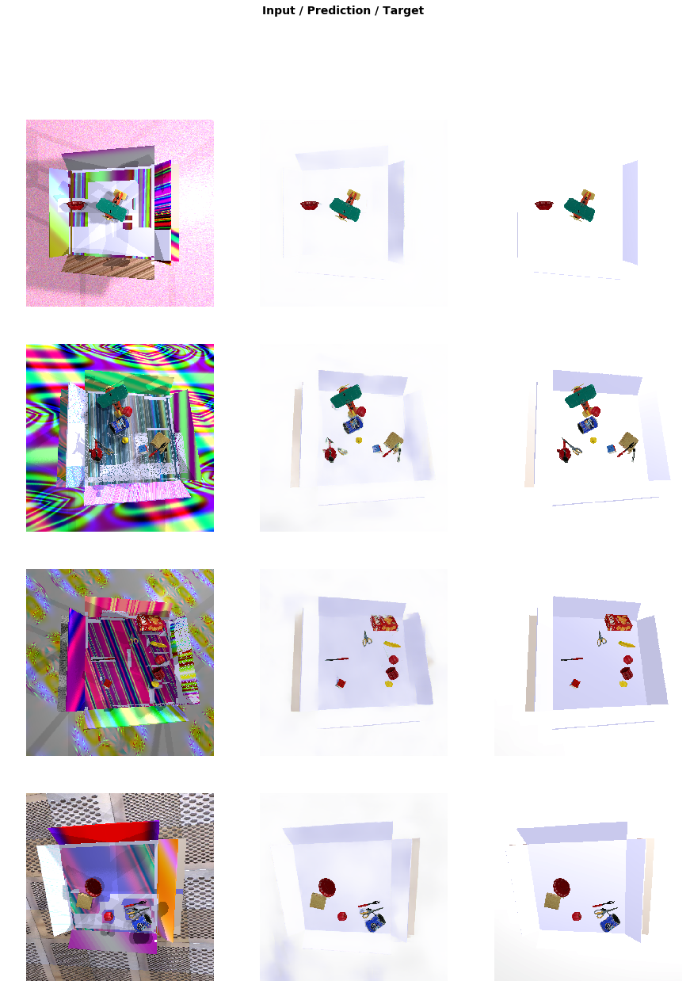

In [60]:
do_fit('3c_v2',lrs=slice(1e-7), n_cycles=2)

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


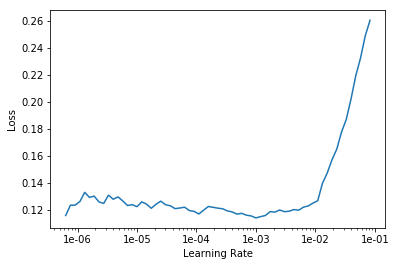

In [68]:
learn.unfreeze()
learn.lr_find()
learn.recorder.plot()

epoch,train_loss,valid_loss,pixel,feat_0,feat_1,feat_2,gram_0,gram_1,gram_2
1,0.108977,0.068912,0.030104,0.009096,0.014254,0.015450,0.000001,0.000005,0.000001
2,0.101298,0.067289,0.029017,0.008903,0.013944,0.015419,0.000001,0.000005,0.000001
3,0.124528,0.064649,0.027449,0.008616,0.013458,0.015120,0.000001,0.000004,0.000001


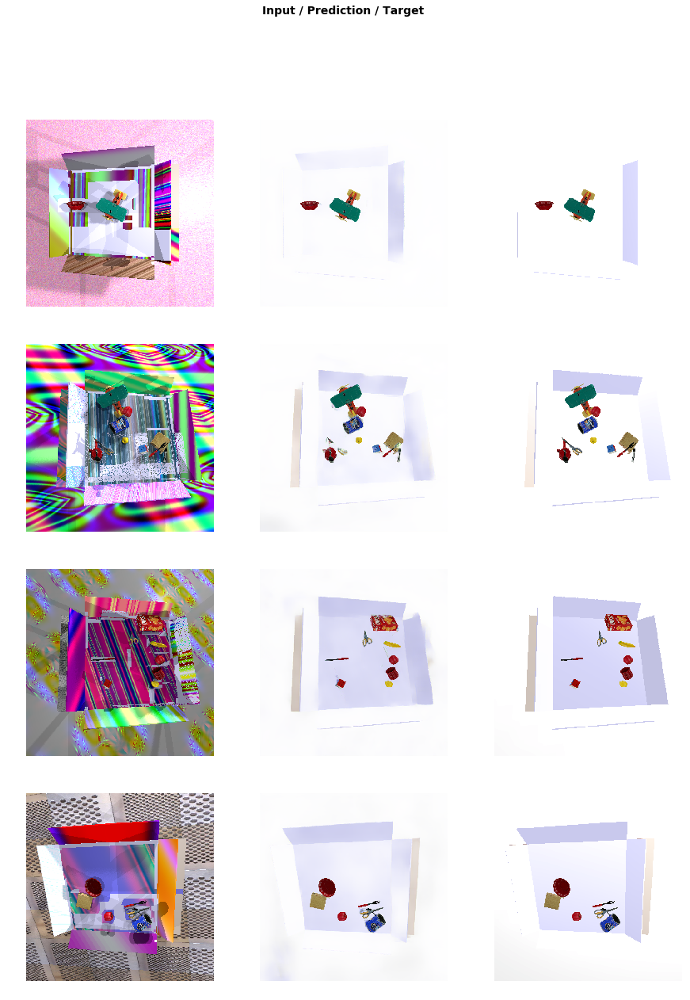

In [69]:
do_fit('3d_v2',lrs=slice(1e-5), n_cycles=3)

In [ ]:
do_fit('3d_v2',lrs=slice(1e-6), n_cycles=3)

epoch,train_loss,valid_loss,pixel,feat_0,feat_1,feat_2,gram_0,gram_1,gram_2
1,0.097114,0.065118,0.027802,0.008636,0.013505,0.015169,0.000001,0.000005,0.000001


## Test

In [70]:
learn.load('3d_v2')

Learner(data=ImageDataBunch;

Train: LabelList
y: ImageItemList (96674 items)
[Image (3, 512, 512), Image (3, 512, 512), Image (3, 512, 512), Image (3, 512, 512), Image (3, 512, 512)]...
Path: /home/dl/data/vrep/v2/cam_1_tex
x: ImageImageList (96674 items)
[Image (3, 512, 512), Image (3, 512, 512), Image (3, 512, 512), Image (3, 512, 512), Image (3, 512, 512)]...
Path: /home/dl/data/vrep/v2/cam_1_tex;

Valid: LabelList
y: ImageItemList (10741 items)
[Image (3, 512, 512), Image (3, 512, 512), Image (3, 512, 512), Image (3, 512, 512), Image (3, 512, 512)]...
Path: /home/dl/data/vrep/v2/cam_1_tex
x: ImageImageList (10741 items)
[Image (3, 512, 512), Image (3, 512, 512), Image (3, 512, 512), Image (3, 512, 512), Image (3, 512, 512)]...
Path: /home/dl/data/vrep/v2/cam_1_tex;

Test: None, model=DynamicUnet(
  (layers): ModuleList(
    (0): Sequential(
      (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, af

In [71]:
import glob
test_files = glob.glob('/home/dl/data/vrep/v1/vrep_test/cam_1_tex/*.*')

In [72]:
img = open_image(test_files[0])

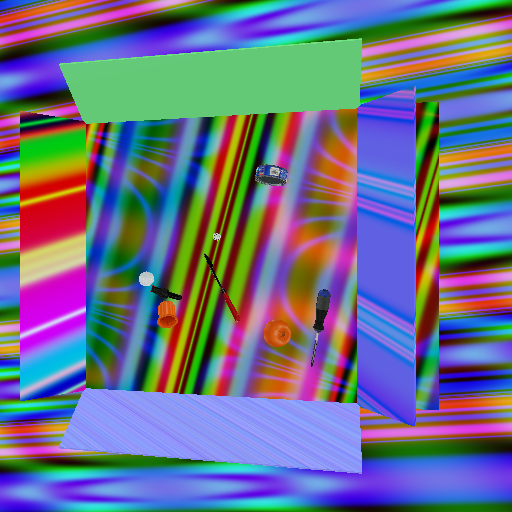

In [73]:
img

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

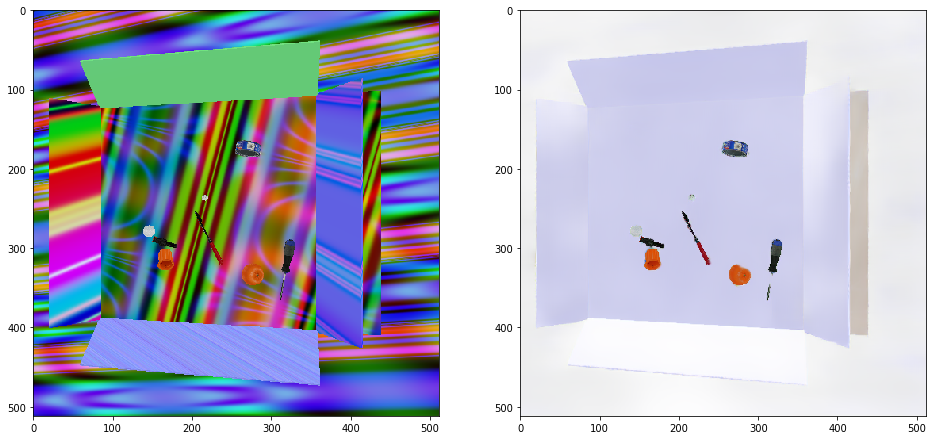

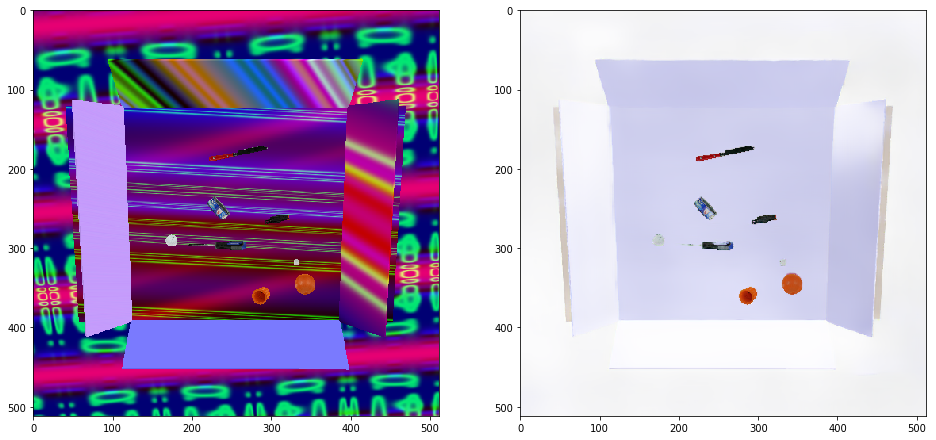

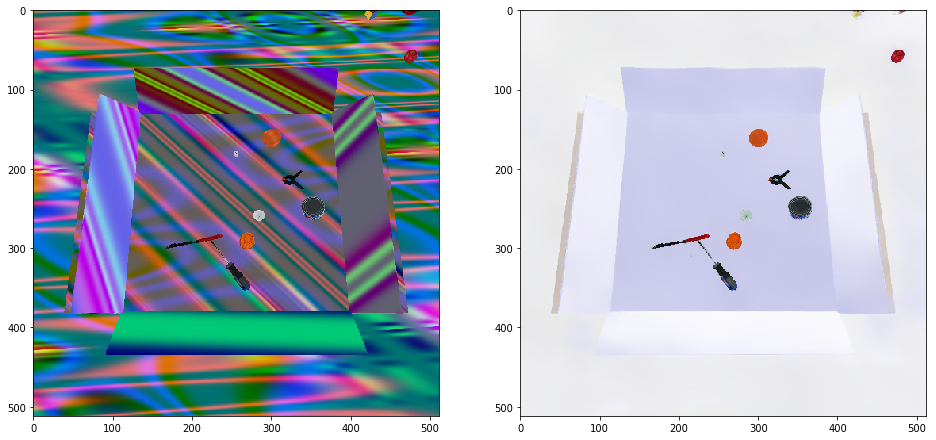

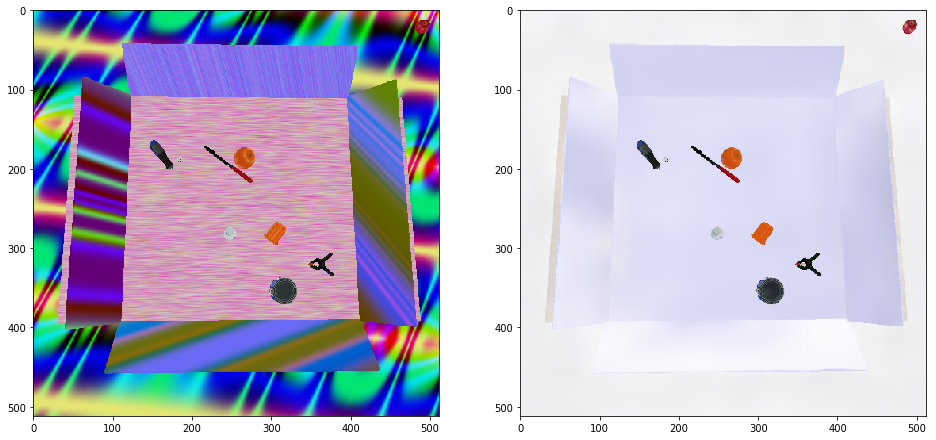

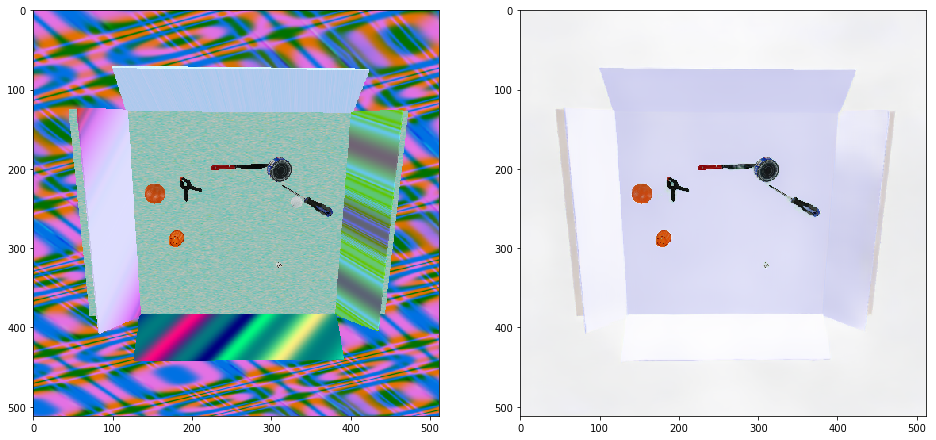

...

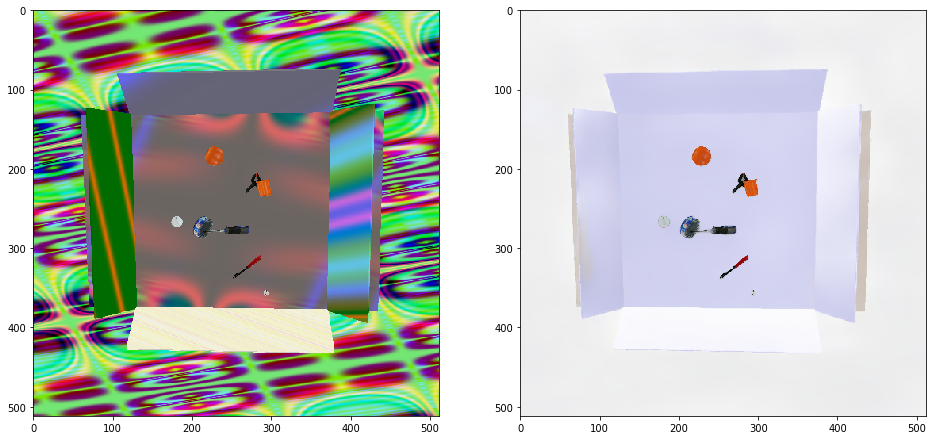

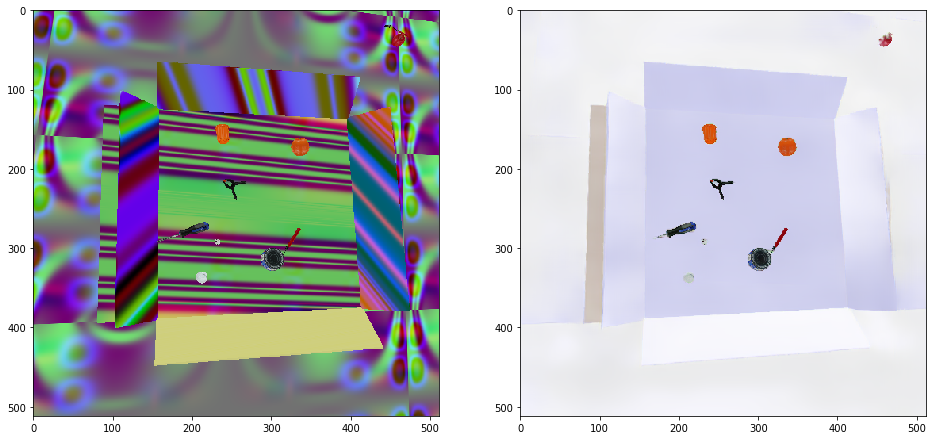

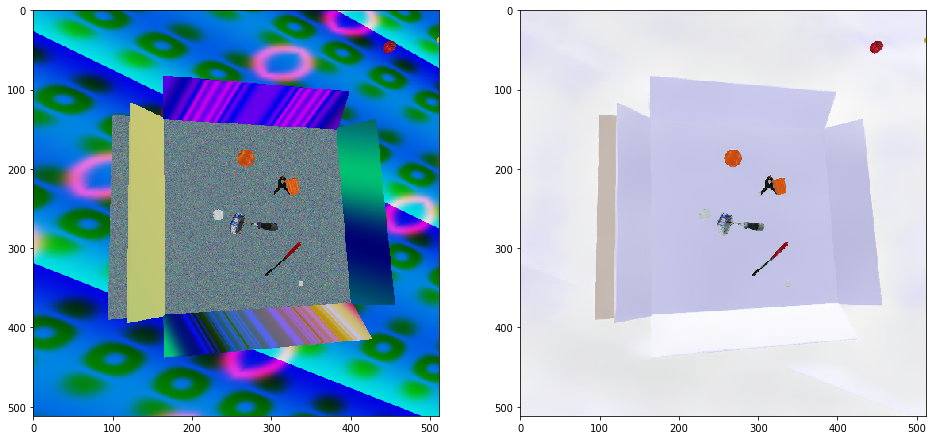

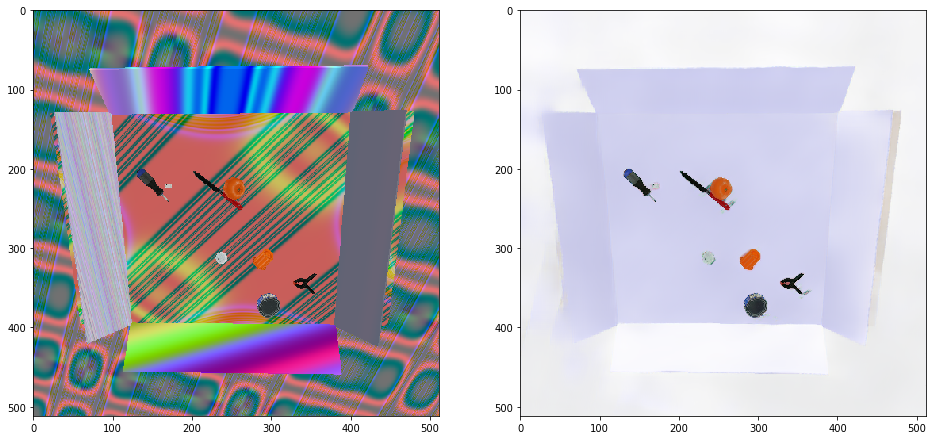

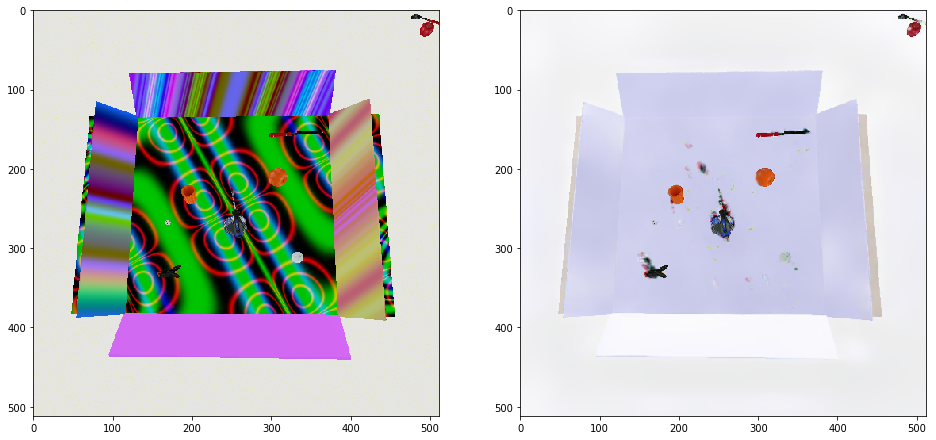

In [74]:
for file in test_files:
    img = open_image(file);
    plt.figure(None, figsize=(16,12))
    plt.subplot(1,2,1)
    plt.imshow(img.data.permute(1,2,0).numpy())
    plt.subplot(1,2,2)
    _,img_hr,b = learn.predict(img)
    plt.imshow(img_hr.permute(1,2,0).numpy())
plt.show()

In [75]:
import glob
test_files = glob.glob('test/3/*.*')
len(test_files)

25

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

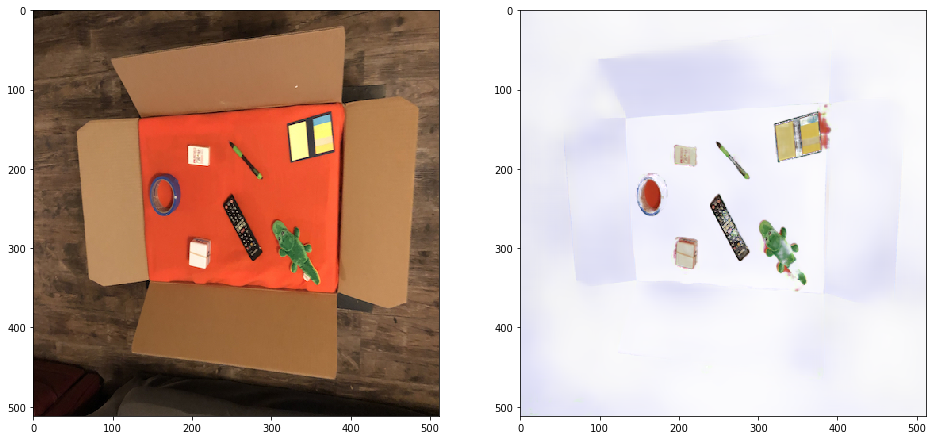

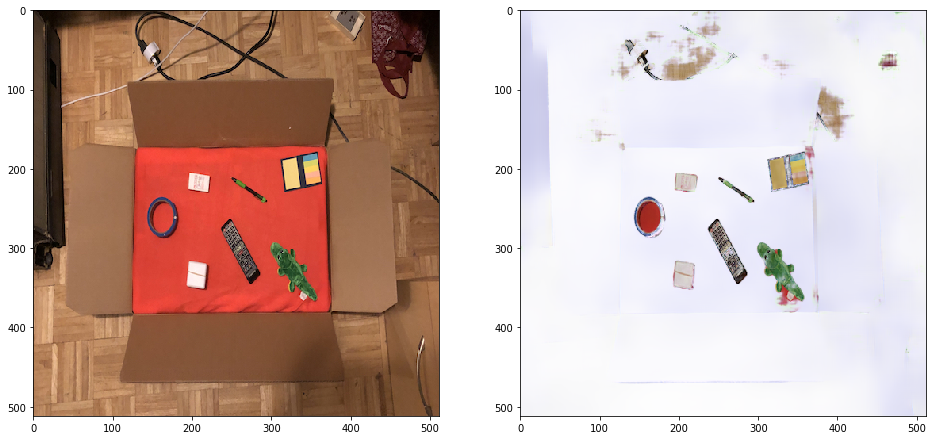

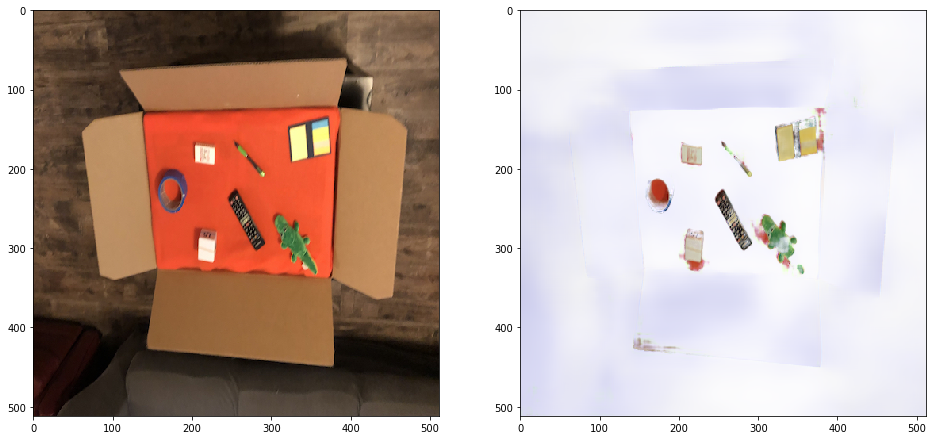

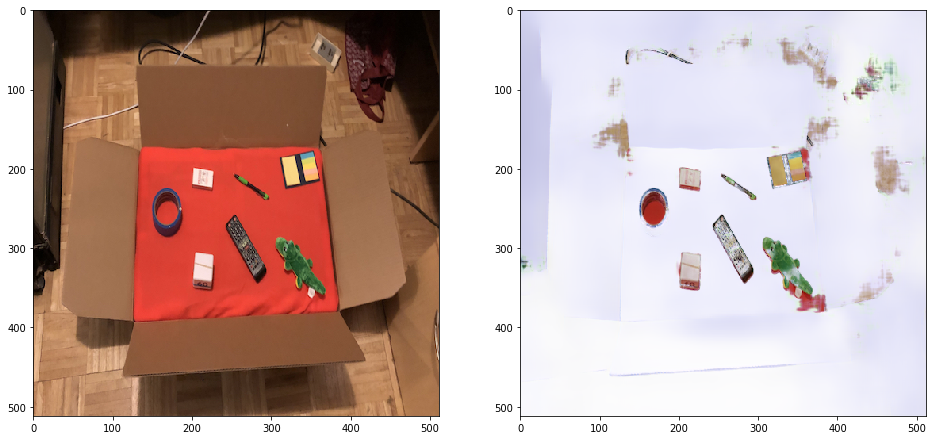

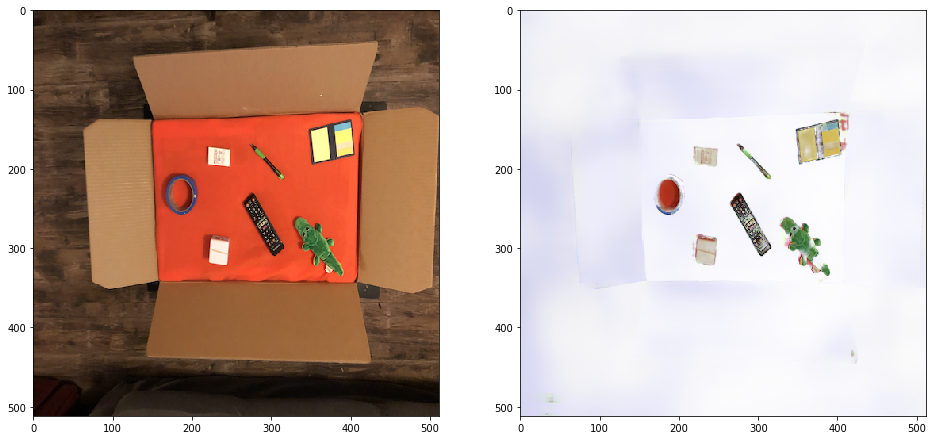

...

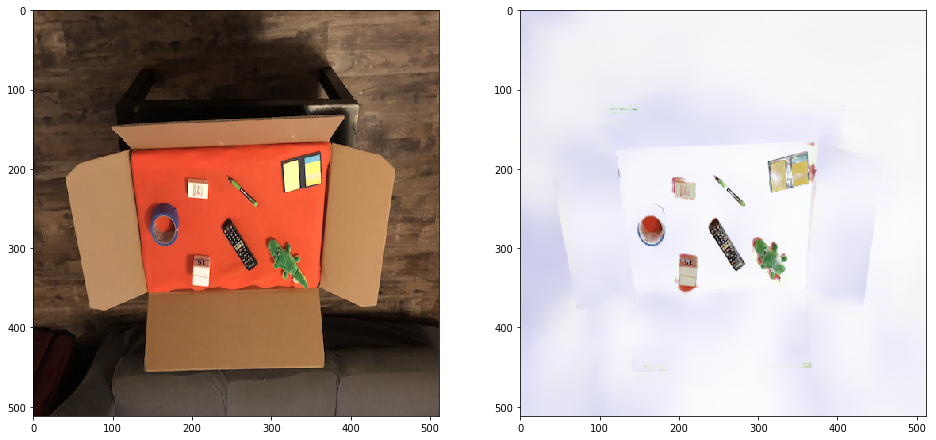

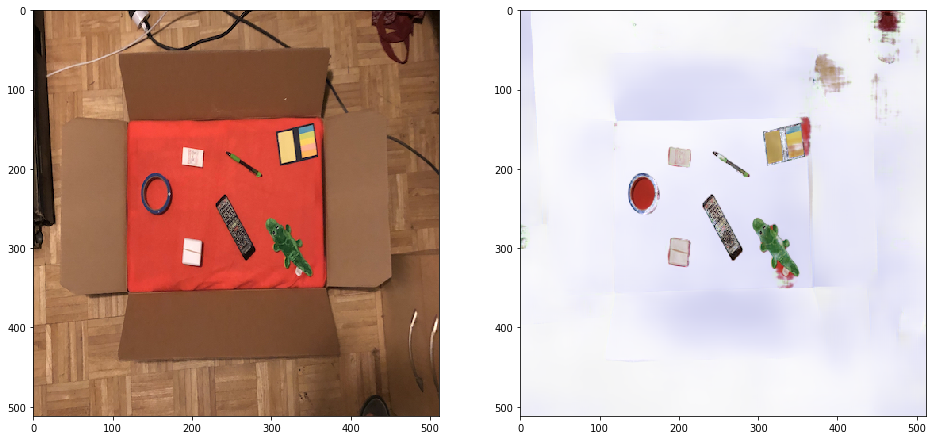

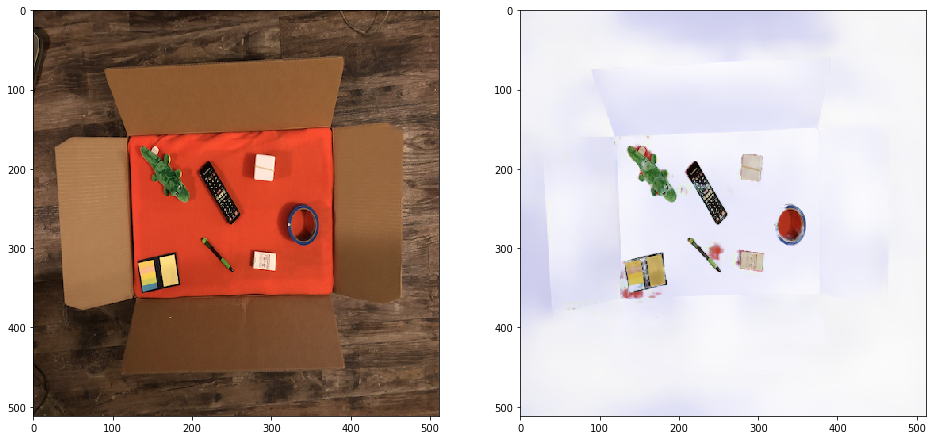

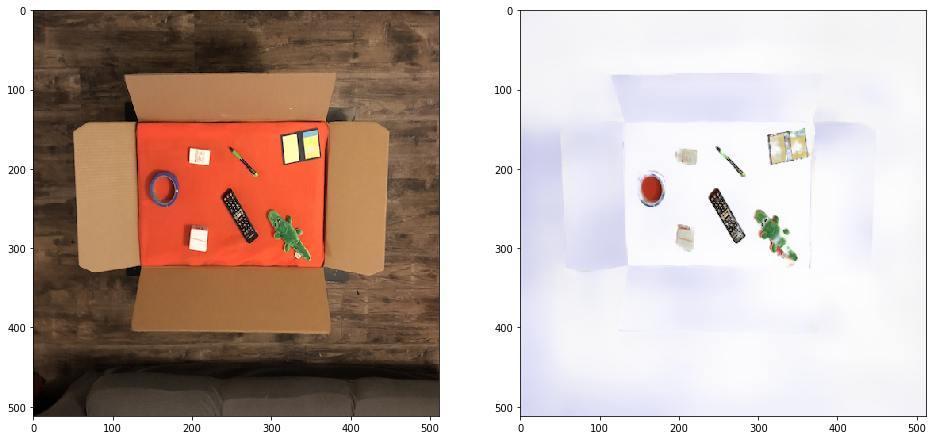

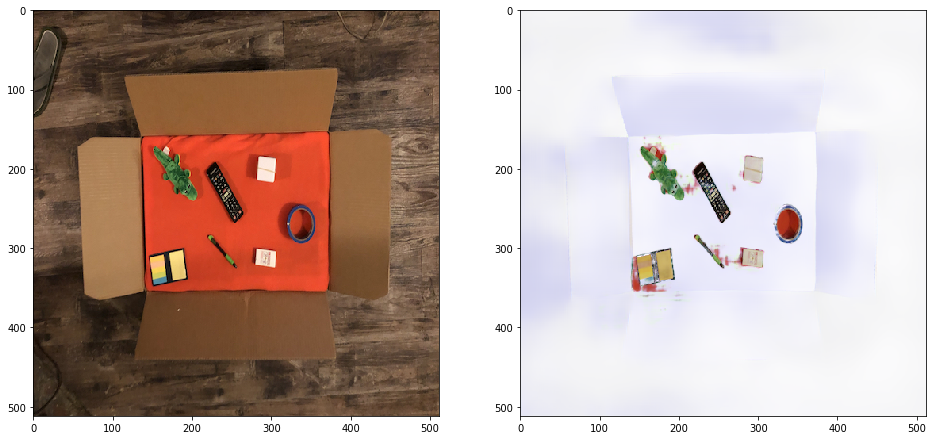

In [76]:
for file in test_files:
    img = open_image(file);
    plt.figure(None, figsize=(16,12))
    plt.subplot(1,2,1)
    plt.imshow(img.data.permute(1,2,0).numpy())
    plt.subplot(1,2,2)
    _,img_hr,b = learn.predict(img)
    plt.imshow(img_hr.permute(1,2,0).numpy())
plt.show()